# Spatial dense data construction with SpatialZ

## Import packages and set configurations

In [1]:
import warnings
warnings.filterwarnings("ignore")

In [2]:
# Import SpatialZ package
from SpatialZ import *

In [3]:
import scanpy as sc
import numpy as np
import pandas as pd
import anndata as ad
import os
import matplotlib.pyplot as plt

## Data preprocessing

In [4]:
def merge_h5ad_files(directory):

    h5ad_files = [f for f in os.listdir(directory) if f.endswith('.h5ad')]

    adatas = []
    
    for file in h5ad_files:
        adata = sc.read_h5ad(os.path.join(directory, file))
        adatas.append(adata)
    
    merged_adata = ad.concat(adatas, join='outer', merge='same')

    return merged_adata

In [5]:
directory_path = './data/merfish'
adata_all = merge_h5ad_files(directory_path)

In [6]:
adata_all

AnnData object with n_obs × n_vars = 28317 × 155
    obs: 'cell_class', 'neuron_class', 'domain', 'Region', 'annotation', 'slice_id'
    obsm: 'spatial'

In [7]:
np.unique(adata_all.obs['slice_id'])

array(['0.04', '0.09', '0.14', '0.19', '0.24'], dtype=object)

In [8]:
all_section_order = np.unique(adata_all.obs['slice_id'])
all_section_order

array(['0.04', '0.09', '0.14', '0.19', '0.24'], dtype=object)

In [9]:
z_values = {slice_id: 400 * (i + 1) for i, slice_id in enumerate(all_section_order)}

adata_all.obs['Z'] = adata_all.obs['slice_id'].map(z_values)

In [10]:
adata_all.obs['X'] = adata_all.obsm['spatial'][:, 0]

adata_all.obs['Y'] = adata_all.obsm['spatial'][:, 1]

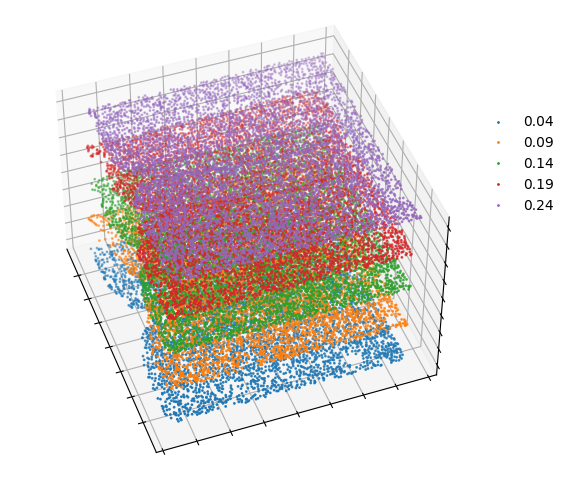

In [11]:
# Visualization on original sparsely sampling data

fig = plt.figure(figsize=(6, 6))
ax1 = fig.add_subplot(111, projection='3d')



for it, label in enumerate(all_section_order):
    temp_Coor = adata_all.obs[adata_all.obs['slice_id'] == label]
    temp_xd = temp_Coor['X']
    temp_yd = temp_Coor['Y']
    temp_zd = temp_Coor['Z']
    ax1.scatter3D(temp_xd, temp_yd, temp_zd,  s=1, marker="o", label=label)

ax1.set_xlabel('')
ax1.set_ylabel('')
ax1.set_zlabel('')

ax1.set_xticklabels([])
ax1.set_yticklabels([])
ax1.set_zticklabels([])

plt.legend(bbox_to_anchor=(1, 0.8), markerscale=1, frameon=False)

ax1.elev = 45
ax1.azim = -20

plt.show()

In [12]:
adatas_id_list = ['0.04', '0.09', '0.14', '0.19', '0.24']
adatas_id_list

['0.04', '0.09', '0.14', '0.19', '0.24']

In [13]:
adata_list = [adata_all[adata_all.obs['slice_id'] == section_id].copy() for section_id in adatas_id_list]
adata_list

[AnnData object with n_obs × n_vars = 5488 × 155
     obs: 'cell_class', 'neuron_class', 'domain', 'Region', 'annotation', 'slice_id', 'Z', 'X', 'Y'
     obsm: 'spatial',
 AnnData object with n_obs × n_vars = 5557 × 155
     obs: 'cell_class', 'neuron_class', 'domain', 'Region', 'annotation', 'slice_id', 'Z', 'X', 'Y'
     obsm: 'spatial',
 AnnData object with n_obs × n_vars = 5926 × 155
     obs: 'cell_class', 'neuron_class', 'domain', 'Region', 'annotation', 'slice_id', 'Z', 'X', 'Y'
     obsm: 'spatial',
 AnnData object with n_obs × n_vars = 5803 × 155
     obs: 'cell_class', 'neuron_class', 'domain', 'Region', 'annotation', 'slice_id', 'Z', 'X', 'Y'
     obsm: 'spatial',
 AnnData object with n_obs × n_vars = 5543 × 155
     obs: 'cell_class', 'neuron_class', 'domain', 'Region', 'annotation', 'slice_id', 'Z', 'X', 'Y'
     obsm: 'spatial']

In [14]:
adata_all.obs

,cell_class,neuron_class,domain,Region,annotation,slice_id,Z,X,Y
Unnamed: 0,,,,,,,,,
1148x-733,Microglia,NaN,MPA,MPA,MPA,0.19,1600,-893.764412,-759.632252
1150x-713,OD Mature 1,NaN,MPA,MPA,MPA,0.19,1600,-892.355504,-739.512027
1154x-761,Pericytes,NaN,MPA,MPA,MPA,0.19,1600,-887.772490,-787.484829
1162x-823,Pericytes,NaN,MPA,MPA,MPA,0.19,1600,-879.402558,-849.248706
1174x-690,Microglia,NaN,MPA,MPA,MPA,0.19,1600,-868.628006,-716.737968
...,...,...,...,...,...,...,...,...,...
-1431x4324,Inhibitory,I-19,BST,BST,BST,0.04,400,717.016661,594.801919
-1347x4422,Inhibitory,I-11,BST,BST,BST,0.04,400,800.626757,692.290678
-1365x4412,Inhibitory,I-9,BST,BST,BST,0.04,400,782.569763,683.022899


In [15]:
adata_all.X

array([[0.        , 0.        , 0.        , ..., 0.00976636, 0.00435998,
        0.        ],
       [0.        , 0.        , 2.3637214 , ..., 0.        , 0.        ,
        0.        ],
       [0.        , 0.        , 2.376603  , ..., 0.04077056, 0.01528226,
        0.        ],
       ...,
       [0.        , 0.        , 0.        , ..., 0.        , 0.00727418,
        0.00530444],
       [0.        , 0.6277586 , 3.1387577 , ..., 0.        , 0.01738001,
        0.02959162],
       [0.        , 0.        , 0.        , ..., 0.        , 0.0042025 ,
        0.00865513]], dtype=float32)

In [16]:
number = 3
number_list = [number] * (len(adatas_id_list) - 1)

## Running SpatialZ to generate multiple slices from a list of tissue sections

In [17]:
import time
start_time = time.time()

adatas = Generate_multiple_slices(adata_list= adata_list, 
                                  num_sim_list = number_list, 
                                  adatas_id_list= adatas_id_list , 
                                  save_path= './output',
                                  device='cuda:0',
                                  nb_iter_max=1000,
                                  cell_type_key='cell_class',
                                  k_sam=50,
                                  syn_mode= 'default', 
                                  Beta = 1,
                                  add_obs_list=['neuron_class', 'domain', 'Region', 'annotation'],
                                  include_raw=True)

end_time = time.time()

Generating simulations for slices:   0%|          | 0/4 [00:00<?, ?it/s]

Begin to generate spatial coordinates......
coordinate initialization time: 1.09 seconds
Iteration 0: Loss = 5.544589519500732
Ot optimization time: 7.88 seconds
Begin to determine cell types......
Cell type determination time: 5.62 seconds
Begin to transfer the attribute......
Transfer the attribute time: 0.13 seconds
Begin to calculate micro-environment measurement......
Micro-environment measurement time: 16.67 seconds
Begin to synthesize gene expression......
Gene expression synthesis time: 29.08 seconds
Completed 0.04-0.09-1 generated and saved!
Begin to generate spatial coordinates......
coordinate initialization time: 0.00 seconds
Iteration 0: Loss = 7.194208145141602
Ot optimization time: 7.17 seconds
Begin to determine cell types......
Cell type determination time: 5.84 seconds
Begin to transfer the attribute......
Transfer the attribute time: 0.16 seconds
Begin to calculate micro-environment measurement......
Micro-environment measurement time: 19.30 seconds
Begin to synthesi

Generating simulations for slices:  25%|██▌       | 1/4 [03:03<09:10, 183.54s/it]

Gene expression synthesis time: 30.02 seconds
Completed 0.04-0.09-3 generated and saved!
Begin to generate spatial coordinates......
coordinate initialization time: 0.00 seconds
Iteration 0: Loss = 6.906851768493652
Ot optimization time: 7.26 seconds
Begin to determine cell types......
Cell type determination time: 5.79 seconds
Begin to transfer the attribute......
Transfer the attribute time: 0.14 seconds
Begin to calculate micro-environment measurement......
Micro-environment measurement time: 19.13 seconds
Begin to synthesize gene expression......
Gene expression synthesis time: 30.41 seconds
Completed 0.09-0.14-1 generated and saved!
Begin to generate spatial coordinates......
coordinate initialization time: 0.00 seconds
Iteration 0: Loss = 8.83037281036377
Ot optimization time: 7.31 seconds
Begin to determine cell types......
Cell type determination time: 5.84 seconds
Begin to transfer the attribute......
Transfer the attribute time: 0.14 seconds
Begin to calculate micro-environme

Generating simulations for slices:  50%|█████     | 2/4 [06:09<06:09, 184.99s/it]

Gene expression synthesis time: 31.24 seconds
Completed 0.09-0.14-3 generated and saved!
Begin to generate spatial coordinates......
coordinate initialization time: 0.00 seconds
Iteration 0: Loss = 4.106593608856201
Ot optimization time: 7.44 seconds
Begin to determine cell types......
Cell type determination time: 6.02 seconds
Begin to transfer the attribute......
Transfer the attribute time: 0.14 seconds
Begin to calculate micro-environment measurement......
Micro-environment measurement time: 18.66 seconds
Begin to synthesize gene expression......
Gene expression synthesis time: 31.74 seconds
Completed 0.14-0.19-1 generated and saved!
Begin to generate spatial coordinates......
coordinate initialization time: 0.00 seconds
Iteration 0: Loss = 5.262857437133789
Ot optimization time: 7.41 seconds
Begin to determine cell types......
Cell type determination time: 5.96 seconds
Begin to transfer the attribute......
Transfer the attribute time: 0.15 seconds
Begin to calculate micro-environm

Generating simulations for slices:  75%|███████▌  | 3/4 [09:22<03:08, 188.50s/it]

Gene expression synthesis time: 31.00 seconds
Completed 0.14-0.19-3 generated and saved!
Begin to generate spatial coordinates......
coordinate initialization time: 0.00 seconds
Iteration 0: Loss = 4.385869979858398
Ot optimization time: 7.26 seconds
Begin to determine cell types......
Cell type determination time: 5.99 seconds
Begin to transfer the attribute......
Transfer the attribute time: 0.14 seconds
Begin to calculate micro-environment measurement......
Micro-environment measurement time: 18.17 seconds
Begin to synthesize gene expression......
Gene expression synthesis time: 31.33 seconds
Completed 0.19-0.24-1 generated and saved!
Begin to generate spatial coordinates......
coordinate initialization time: 0.00 seconds
Iteration 0: Loss = 5.350555419921875
Ot optimization time: 7.21 seconds
Begin to determine cell types......
Cell type determination time: 5.77 seconds
Begin to transfer the attribute......
Transfer the attribute time: 0.14 seconds
Begin to calculate micro-environm

Generating simulations for slices: 100%|██████████| 4/4 [12:27<00:00, 187.00s/it]

Gene expression synthesis time: 29.85 seconds
Completed 0.19-0.24-3 generated and saved!


In [18]:
elapsed_time = end_time - start_time
print(f"Time taken to create all data: {elapsed_time:.6f} seconds")

Time taken to create all data: 748.315443 seconds


In [19]:
adatas

AnnData object with n_obs × n_vars = 96717 × 155
    obs: 'cell_class', 'neuron_class', 'domain', 'Region', 'annotation', 'slice_id', 'Z', 'X', 'Y', 'data_type'
    obsm: 'spatial'

In [20]:
np.unique(adatas.obs['slice_id'])

array(['0.04', '0.04-0.09-1', '0.04-0.09-2', '0.04-0.09-3', '0.09',
       '0.09-0.14-1', '0.09-0.14-2', '0.09-0.14-3', '0.14', '0.14-0.19-1',
       '0.14-0.19-2', '0.14-0.19-3', '0.19', '0.19-0.24-1', '0.19-0.24-2',
       '0.19-0.24-3', '0.24'], dtype=object)

In [21]:
np.unique(adatas.obs['data_type'])

array(['real', 'synthetic'], dtype=object)

In [22]:
adatas.write_h5ad('./dense_data/merfish_interp3.h5ad')

## Downstream analysis

In [23]:
z_values = {slice_id: 100 * (i + 1) for i, slice_id in enumerate(np.unique(adatas.obs['slice_id']))}

adatas.obs['Z'] = adatas.obs['slice_id'].map(z_values)

In [24]:
adatas.obs['X'] = adatas.obsm['spatial'][:, 0]

adatas.obs['Y'] = adatas.obsm['spatial'][:, 1]

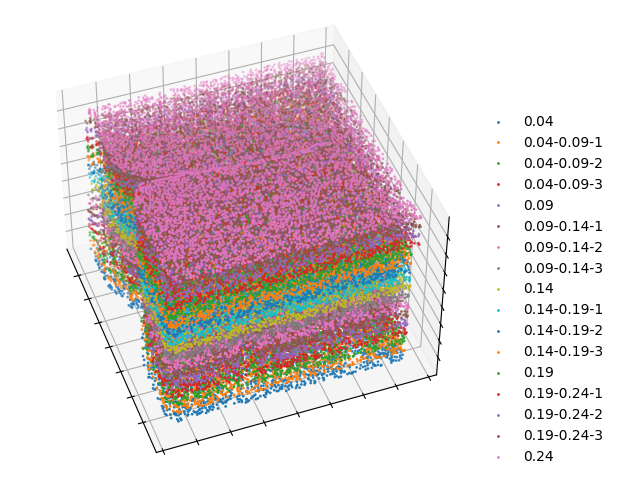

In [25]:
# Visualization on SpatialZ-reconstructed densely spatial data

fig = plt.figure(figsize=(6, 6))
ax1 = fig.add_subplot(111, projection='3d')



for it, label in enumerate(np.unique(adatas.obs['slice_id'])):
    temp_Coor = adatas.obs[adatas.obs['slice_id'] == label]
    temp_xd = temp_Coor['X']
    temp_yd = temp_Coor['Y']
    temp_zd = temp_Coor['Z']
    ax1.scatter3D(temp_xd, temp_yd, temp_zd,  s=1, marker="o", label=label)

ax1.set_xlabel('')
ax1.set_ylabel('')
ax1.set_zlabel('')

ax1.set_xticklabels([])
ax1.set_yticklabels([])
ax1.set_zticklabels([])

plt.legend(bbox_to_anchor=(1, 0.8), markerscale=1, frameon=False)

ax1.elev = 45
ax1.azim = -20

plt.show()

In [26]:
sc.tl.pca(adatas, svd_solver='arpack')
sc.pp.neighbors(adatas)
sc.tl.umap(adatas,min_dist=0.8)

### UMAP on the SpatialZ-reconstructed dense spatial data colored by different slices 

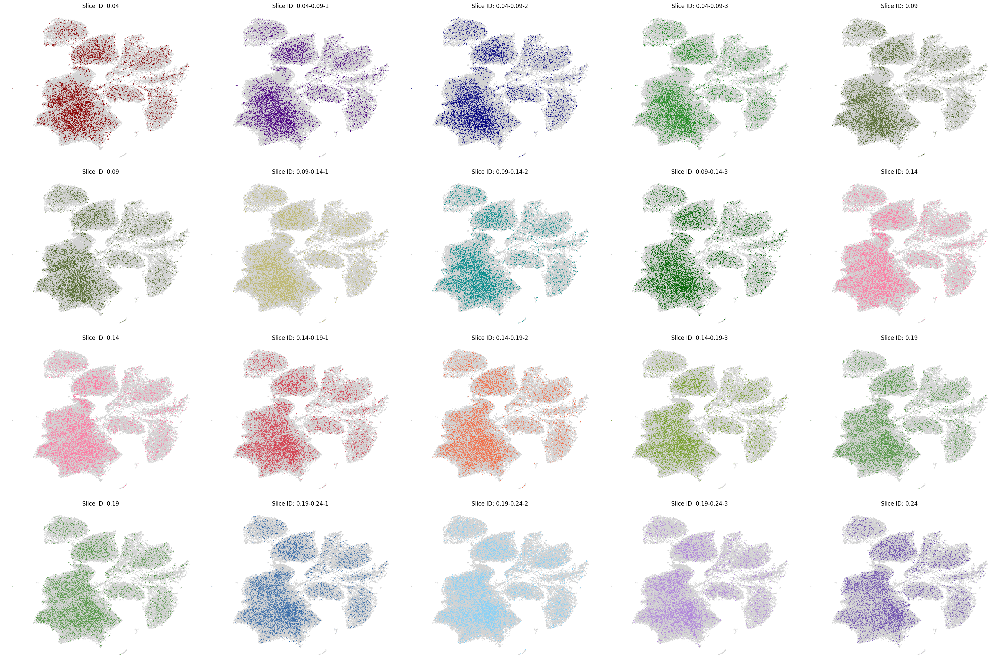

In [27]:
import scanpy as sc
import matplotlib.pyplot as plt

# Define the color palette for regions
slice_colors = {
    '0.04':        '#8B0000',  
    '0.04-0.09-1': '#4B0082',  
    '0.04-0.09-2': '#000080',  
    '0.04-0.09-3': '#228B22', 
    '0.09':        '#556B2F',  
    '0.09-0.14-1': '#BDB76B', 
    '0.09-0.14-2': '#008B8B',  
    '0.09-0.14-3': '#006400',   
    '0.14':        '#FF7AA3',  
    '0.14-0.19-1': '#D54151',  
    '0.14-0.19-2': '#F46C44',  
    '0.14-0.19-3': '#78A02D', 
    '0.19':        '#549745',  
    '0.19-0.24-1': '#386DAA', 
    '0.19-0.24-2': '#86D1F8',  
    '0.19-0.24-3': '#B185DC', 
    '0.24':        '#7051B1',      
}

# Create a large figure to accommodate the subplots
fig, axs = plt.subplots(4, 5, figsize=(30, 20))  # Adjust figsize as needed

# Flatten the array of axes to simplify accessing them in the loop
axs = axs.flatten()

# Define the exact order of slice_ids as specified
slice_ids_order = [
    '0.04', '0.04-0.09-1', '0.04-0.09-2', '0.04-0.09-3', '0.09',
    '0.09', '0.09-0.14-1', '0.09-0.14-2', '0.09-0.14-3', '0.14',
    '0.14', '0.14-0.19-1', '0.14-0.19-2', '0.14-0.19-3', '0.19',
    '0.19', '0.19-0.24-1', '0.19-0.24-2', '0.19-0.24-3', '0.24'
]

# Loop through each specified slice_id and plot
for i, slice_id in enumerate(slice_ids_order):
    use_adata = adatas[adatas.obs['slice_id'] == slice_id]
    title = f'Slice ID: {slice_id}'
    
    ax = sc.pl.umap(adatas, color='slice_id', size=10, title=title, 
                    groups=[slice_id],
                    palette=slice_colors, 
                    legend_loc='none', frameon=False, show=False, ax=axs[i])
    axs[i].set_xlabel('')
    axs[i].set_ylabel('')
    axs[i].set_axis_off()

plt.tight_layout()  # Adjust layout to

### Cell type distribution on the UMAP in the SpatialZ-reconstructed densely spatial data

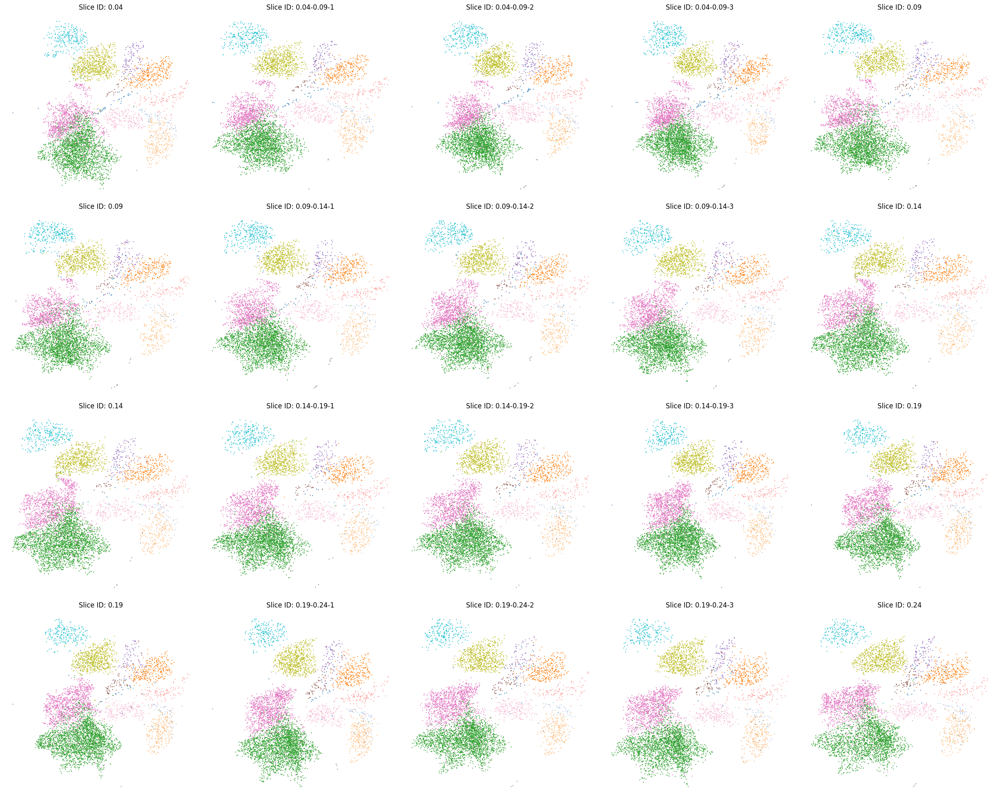

In [28]:

ct_colors = {
    'Astrocyte':     '#bcbd22',     
    'Endothelial 1': '#ff7f0e',   
    'Endothelial 2': '#1f77b4',   
    'Endothelial 3': '#9467bd',  
    'Ependymal':     '#17becf',   
    'Excitatory':    '#e377c2',      
    'Inhibitory':    '#2ca02c',      
    'Microglia':     '#ff9896',    
    'Pericytes':     '#8c564b',   
    'OD Immature 1': '#f7b6d2',   
    'OD Immature 2': '#c49c94',   
    'OD Mature 1':   '#aec7e8',   
    'OD Mature 2':   '#ffbb78',   
    'OD Mature 3':   '#98df8a',  
    'OD Mature 4':   '#7f7f7f'    
}


# Create a large figure to accommodate the subplots
fig, axs = plt.subplots(4, 5, figsize=(25, 20))  # Adjust figsize as needed

# Flatten the array of axes to simplify accessing them in the loop
axs = axs.flatten()

# Define the exact order of slice_ids as specified
slice_ids_order = [
    '0.04', '0.04-0.09-1', '0.04-0.09-2', '0.04-0.09-3', '0.09',
    '0.09', '0.09-0.14-1', '0.09-0.14-2', '0.09-0.14-3', '0.14',
    '0.14', '0.14-0.19-1', '0.14-0.19-2', '0.14-0.19-3', '0.19',
    '0.19', '0.19-0.24-1', '0.19-0.24-2', '0.19-0.24-3', '0.24'
]

# Loop through each specified slice_id and plot
for i, slice_id in enumerate(slice_ids_order):
    use_adata = adatas[adatas.obs['slice_id'] == slice_id]
    title = f'Slice ID: {slice_id}'
    ax = sc.pl.umap(use_adata, color='cell_class', size=10, title=title, palette=ct_colors,
                    legend_loc=None, frameon=False, show=False, ax=axs[i])
    axs[i].set_xlabel('')
    axs[i].set_ylabel('')
    axs[i].set_axis_off()

plt.tight_layout()  # Adjust layout to minimize overlap
plt.show()  # Display the plot


### Molecular-defined cell type visualization under the spatial context

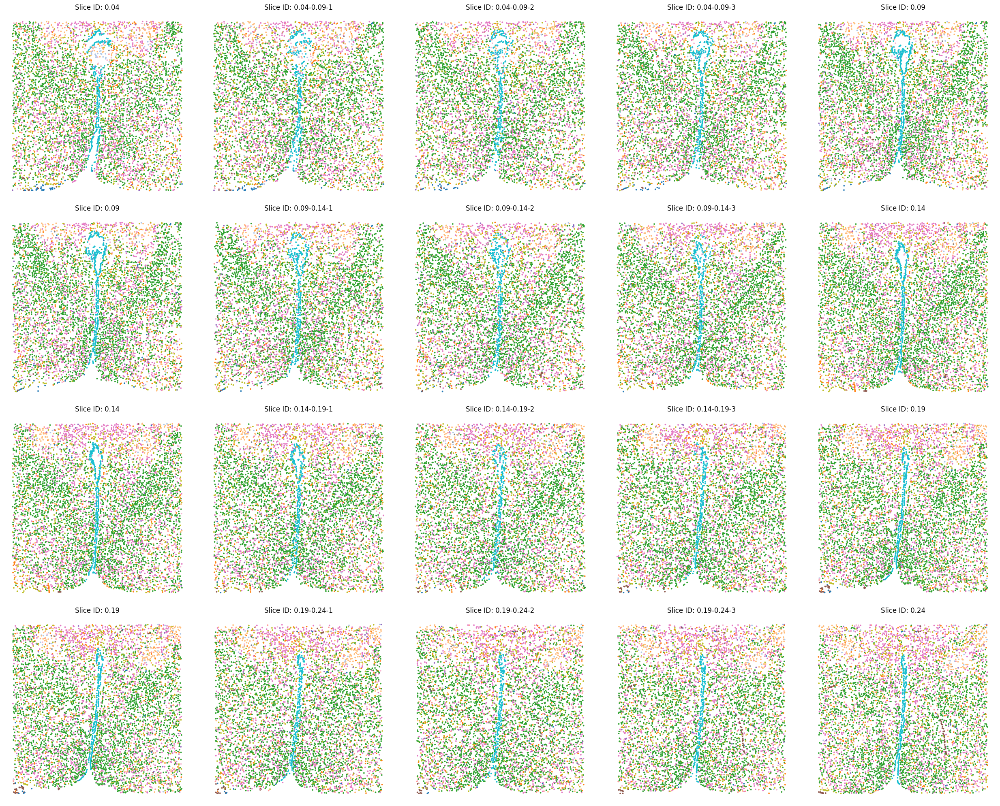

In [29]:

ct_colors = {
    'Astrocyte':     '#bcbd22',      
    'Endothelial 1': '#ff7f0e',   
    'Endothelial 2': '#1f77b4',   
    'Endothelial 3': '#9467bd',  
    'Ependymal':     '#17becf',   
    'Excitatory':    '#e377c2',      
    'Inhibitory':    '#2ca02c',      
    'Microglia':     '#ff9896',       
    'Pericytes':     '#8c564b',       
    'OD Immature 1': '#f7b6d2',   
    'OD Immature 2': '#c49c94',   
    'OD Mature 1':   '#aec7e8',     
    'OD Mature 2':   '#ffbb78',     
    'OD Mature 3':   '#98df8a',
    'OD Mature 4':   '#7f7f7f'       
}


# Create a large figure to accommodate the subplots
fig, axs = plt.subplots(4, 5, figsize=(25, 20))  # Adjust figsize as needed

# Flatten the array of axes to simplify accessing them in the loop
axs = axs.flatten()

# Define the exact order of slice_ids as specified
slice_ids_order = [
    '0.04', '0.04-0.09-1', '0.04-0.09-2', '0.04-0.09-3', '0.09',
    '0.09', '0.09-0.14-1', '0.09-0.14-2', '0.09-0.14-3', '0.14',
    '0.14', '0.14-0.19-1', '0.14-0.19-2', '0.14-0.19-3', '0.19',
    '0.19', '0.19-0.24-1', '0.19-0.24-2', '0.19-0.24-3', '0.24'
]

# Loop through each specified slice_id and plot
for i, slice_id in enumerate(slice_ids_order):
    use_adata = adatas[adatas.obs['slice_id'] == slice_id]
    title = f'Slice ID: {slice_id}'
    
    # Use Scanpy's plotting function
    ax = sc.pl.embedding(use_adata, basis='spatial', color='cell_class', title=title, palette=ct_colors,
                         size=30, alpha=1, show=False, legend_loc='none', ax=axs[i])
    
    
    axs[i].set_xlabel('')
    axs[i].set_ylabel('')
    axs[i].set_aspect('equal')
    axs[i].set_axis_off()

plt.tight_layout()  # Adjust layout to minimize overlap
plt.show()  # Display the plot


### Transferred label visualization under the spatial context

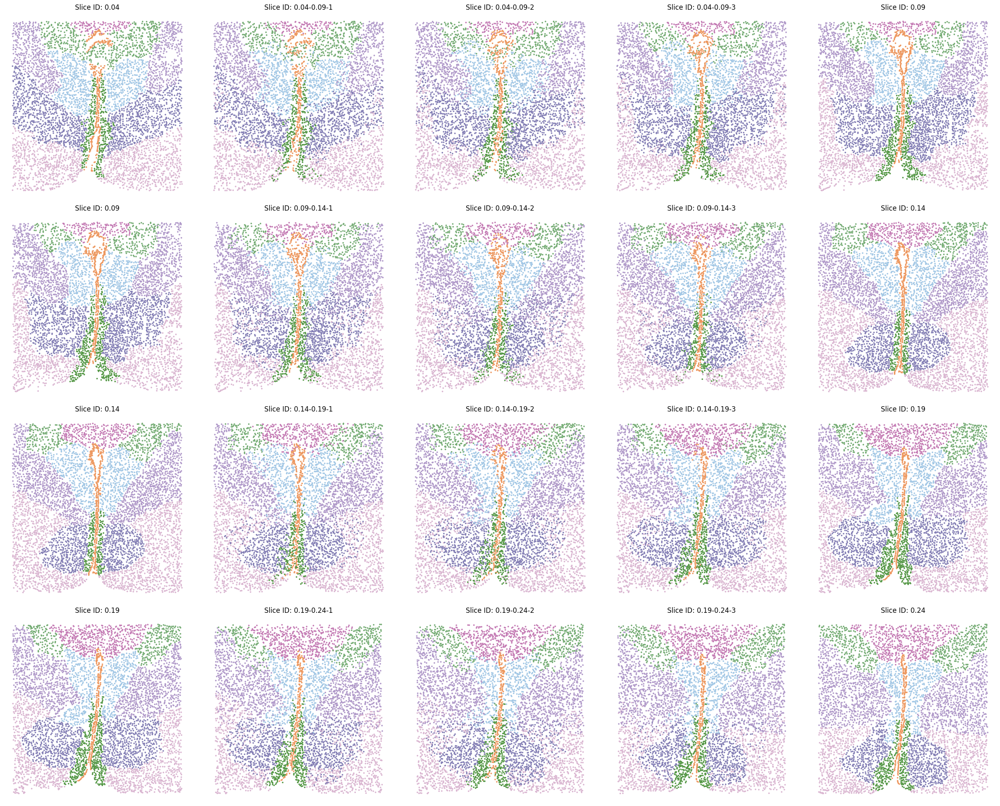

In [30]:

# Define the color palette for regions
label_colors = {
    'PVH': '#A2C7E5',  
    'PVT': '#C47BB4',  
    'BST': '#B099C9',  
    'fx':  '#75AC74',  
    'V3':  '#ED9860',  
    'PV':  '#549745',  
    'MPA': '#DAB6D1',  
    'MPN': '#847FB5'   
}

# Create a large figure to accommodate the subplots
fig, axs = plt.subplots(4, 5, figsize=(25, 20))  # Adjust figsize as needed

# Flatten the array of axes to simplify accessing them in the loop
axs = axs.flatten()

# Define the exact order of slice_ids as specified
slice_ids_order = [
    '0.04', '0.04-0.09-1', '0.04-0.09-2', '0.04-0.09-3', '0.09',
    '0.09', '0.09-0.14-1', '0.09-0.14-2', '0.09-0.14-3', '0.14',
    '0.14', '0.14-0.19-1', '0.14-0.19-2', '0.14-0.19-3', '0.19',
    '0.19', '0.19-0.24-1', '0.19-0.24-2', '0.19-0.24-3', '0.24'
]

# Loop through each specified slice_id and plot
for i, slice_id in enumerate(slice_ids_order):
    use_adata = adatas[adatas.obs['slice_id'] == slice_id]
    title = f'Slice ID: {slice_id}'
    
    # Use Scanpy's plotting function
    ax = sc.pl.embedding(use_adata, basis='spatial', color='Region', title=title, palette=label_colors,
                         size=30, alpha=1, show=False, legend_loc='none', ax=axs[i])
    axs[i].set_xlabel('')
    axs[i].set_ylabel('')
    axs[i].set_aspect('equal')
    axs[i].set_axis_off()

plt.tight_layout()  # Adjust layout to minimize overlap
plt.show()  # Display the plot
